### 项目演示视频


### 1.数据集介绍
   与河南智售宝智能科技有限公司合作，进行实时监控视频的采集与分帧标注。然后进行数据的预处理，得到训练集:测试集:验证集为8:1:1的标准COCO格式数据集，
 数据集文件结构如下：
 ![](https://ai-studio-static-online.cdn.bcebos.com/a77fab897f2f4664a399c9adc97931554df5fed1cbcc453e84390e244b1377b8)

### 2.项目环境


| 名称 | 版本 | 功能说明 |
| -------- | -------- | -------- |
| AIStudio    | BML Codelab	     | 实现代码的基础平台和环境     |
|PaddlePaddle    | 2.6.2     | PaddlePaddle的深度学习框架     |
|python    | 3.10.10    | 默认安装的python版本     |
| PaddleDetection    | 2.8.0     | PaddlePaddle的目标检测端到端开发套件    |
| Streamlit    | 1.50.0     | 可视化工具    |



### 3. 环境配置

In [1]:
# 安装其他依赖
!pip install -r PaddleDetection/requirements.txt

Looking in indexes: https://mirror.baidu.com/pypi/simple/, https://mirrors.aliyun.com/pypi/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.5/60.5 MB 75.3 kB/s eta 0:00:0000:0400:21
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 76.4 kB/s eta 0:00:00a 0:00:03
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 77.8 kB/s eta 0:00:0000:0100:04
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 78.7 kB/s eta 0:00:00a 0:00:02
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 912.2/912.2 kB 79.8 kB/s eta 0:00:00a 0:00:02
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 948.0/948.0 kB 80.1 kB/s eta 0:00:00a 0:00:03
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.8/14.8 MB 77.0 kB/s eta 0:00:0000:0200:08
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 76.5 kB/s eta 0:00:00a 0:00:02
  Created wheel for sklearn: filename=sklearn-0.0-py2.py3-none-any.whl size=1301 sha256=bf9b45ff9e8a548d6e6aebffb4c5bf3144dddf77b368d6fe86cca925a

In [ ]:
## bash
# 编译安装paddledet
cd PaddleDetection
python setup.py install

In [2]:
!pip install numba

Looking in indexes: https://mirror.baidu.com/pypi/simple/, https://mirrors.aliyun.com/pypi/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.7/3.7 MB 78.6 kB/s eta 0:00:0000:0100:05
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 77.8 kB/s eta 0:00:0000:0300:19


### 4.模型训练与评估

In [ ]:
# 模型训练
!python -m paddle.distributed.launch  PaddleDetection/tools/train.py -c PaddleDetection/configs/ppyoloe/ppyoloe_plus_crn_m_80e_coco.yml --eval --amp

LAUNCH INFO 2025-10-23 09:17:33,930 -----------  Configuration  ----------------------
LAUNCH INFO 2025-10-23 09:17:33,930 auto_parallel_config: None
LAUNCH INFO 2025-10-23 09:17:33,930 auto_tuner_json: None
LAUNCH INFO 2025-10-23 09:17:33,930 devices: None
LAUNCH INFO 2025-10-23 09:17:33,930 elastic_level: -1
LAUNCH INFO 2025-10-23 09:17:33,930 elastic_timeout: 30
LAUNCH INFO 2025-10-23 09:17:33,930 enable_gpu_log: True
LAUNCH INFO 2025-10-23 09:17:33,931 gloo_port: 6767
LAUNCH INFO 2025-10-23 09:17:33,931 host: None
LAUNCH INFO 2025-10-23 09:17:33,931 ips: None
LAUNCH INFO 2025-10-23 09:17:33,931 job_id: default
LAUNCH INFO 2025-10-23 09:17:33,931 legacy: False
LAUNCH INFO 2025-10-23 09:17:33,931 log_dir: log
LAUNCH INFO 2025-10-23 09:17:33,931 log_level: INFO
LAUNCH INFO 2025-10-23 09:17:33,931 log_overwrite: False
LAUNCH INFO 2025-10-23 09:17:33,931 master: None
LAUNCH INFO 2025-10-23 09:17:33,931 max_restart: 3
LAUNCH INFO 2025-10-23 09:17:33,931 nnodes: 1
LAUNCH INFO 2025-10-23 0

### 5.模型导出

In [5]:
## 验证模型
!python PaddleDetection/tools/infer.py -c PaddleDetection/configs/ppyoloe/ppyoloe_plus_crn_m_80e_coco.yml --infer_img=data_dir/images/0630_1_113.jpg -o use_gpu=True weights=output/best_model/model.pdparams --infer_img=data_dir/images/0630_1_113.jpg

W1011 11:51:26.284010 40359 gpu_resources.cc:119] Please NOTE: device: 0, GPU Compute Capability: 7.0, Driver API Version: 12.0, Runtime API Version: 11.8
W1011 11:51:26.285092 40359 gpu_resources.cc:164] device: 0, cuDNN Version: 8.9.
[10/11 11:51:31] ppdet.utils.checkpoint INFO: Finish loading model weights: best_model/best_model.pdparams
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
100%|█████████████████████████████████████████████| 1/1 [00:03<00:00,  3.62s/it]
[10/11 11:51:34] ppdet.utils.download INFO: Downloading simfang.ttf from https://paddledet.bj.bcebos.com/simfang.ttf
100%|██████████████████████████████████| 10329/10329 [00:00<00:00, 94187.53KB/s]
[10/11 11:51:35] ppdet.engine INFO: Detection bbox results save in output/0630_1_113.jpg


In [3]:
!pip install imgaug

Looking in indexes: https://mirror.baidu.com/pypi/simple/, https://mirrors.aliyun.com/pypi/simple/


In [7]:
## 导出推理模型，便于后期部署 
!python PaddleDetection/tools/export_model.py -c PaddleDetection/configs/ppyoloe/ppyoloe_plus_crn_m_80e_coco.yml -o weights=PaddleDetection/tools/infer.py -c PaddleDetection/configs/ppyoloe/ppyoloe_plus_crn_m_80e_coco.yml -o weights=output/best_model/model.pdparams --output_dir 'output_inference' 

[10/17 10:43:47] ppdet.utils.checkpoint INFO: Finish loading model weights: output/best_model/model.pdparams
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
[10/17 10:43:47] ppdet.engine INFO: Export inference config file to output_inference/export_model/ppyoloe_plus_crn_m_80e_coco/infer_cfg.yml
I1017 10:43:53.593508 24201 program_interpreter.cc:212] New Executor is Running.
[10/17 10:43:54] ppdet.engine INFO: Export model and saved in output_inference/export_model/ppyoloe_plus_crn_m_80e_coco


### 6.模型部署

In [ ]:
!pip install --user --upgrade streamlit

In [13]:
## 可视化界面设计测试
import onnxruntime as rt
import cv2
import numpy as np

sess = rt.InferenceSession("ppyoloe_plus_crn_m_80e_coco.onnx")
img = cv2.imread("data_dir/images/0630_1_11.jpg")
org_img = img
im_shape = np.array([[float(img.shape[0]), float(img.shape[1])]]).astype('float32')
img = cv2.resize(img, (640,640))
scale_factor = np.array([[float(640/img.shape[0]), float(640/img.shape[1])]]).astype('float32')
img = img.astype(np.float32) / 255.0
input_img = np.transpose(img, [2, 0, 1])
image = input_img[np.newaxis, :, :, :]
output_dict = [
    "save_infer_model/scale_0.tmp_0",
    "save_infer_model/scale_1.tmp_0"
]
inputs_dict = {
    # 'im_shape': im_shape,
    'image': image,
    'scale_factor': scale_factor
}
# # 得到模型输出名
# for output in sess.get_outputs():
#     print(output.name)

result = sess.run(output_dict, inputs_dict)
class_names = [
    "hand", "arm", "handGoods", "argent", "yellow", "green", "grey", "orange",
    "cyan", "black", "scarlet", "red", "blue", "purple", "darkBlue"
    ]

    # 每个类别对应的颜色（BGR格式）
class_colors = {
    "hand": (255, 0, 0),
    "arm": (0, 255, 0),
    "handGoods": (0, 0, 255),
    "argent": (192, 192, 192),
    "yellow": (0, 255, 255),
    "green": (0, 128, 0),
    "grey": (128, 128, 128),
    "orange": (0, 165, 255),
    "cyan": (255, 255, 0),
    "black": (0, 0, 0),
    "scarlet": (34, 34, 178),
    "red": (0, 0, 255),
    "blue": (255, 0, 0),
    "purple": (128, 0, 128),
    "darkBlue": (128, 0, 0)
    }

# 绘制检测结果
for item in result[0]:
    class_id = int(item[0])
    score = item[1]
    if score > 0.5 and class_id < len(class_names):
        class_name = class_names[class_id]
        color = class_colors.get(class_name, (128, 128, 128))  # 默认灰色
        x1, y1, x2, y2 = map(int, item[2:6])
        
        cv2.rectangle(org_img, (x1, y1), (x2, y2), color, 2)
        cv2.putText(org_img, class_name, (x1, y1), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,255,255), 1)

cv2.imwrite("/home/aistudio/work/result.png", org_img)
print("可视化界面设计初步测试成功！！！")

可视化界面设计初步测试成功！！！


In [3]:
import paddle
from paddle.inference import Config, create_predictor
import numpy as np

# 重新导出模型时指定输入shape，支持批量
def export_model_with_batch_support():
    # 加载模型配置
    model_dir = "/home/aistudio/output_inference/ppyoloe_plus_crn_m_80e_coco/"
    
    # 设置配置，支持动态batch
    config = Config(model_dir + "model.pdmodel", model_dir + "model.pdiparams")
    
    # 启用动态shape
    config.enable_use_gpu(100, 0)
    config.switch_ir_optim(True)
    config.enable_memory_optim()
    
    # 设置动态输入，支持batch_size > 1
    config.set_trt_dynamic_shape_info(
        min_input_shape={"image": [1, 3, 640, 640], "scale_factor": [1, 2]},
        max_input_shape={"image": [8, 3, 640, 640], "scale_factor": [8, 2]},
        optim_input_shape={"image": [4, 3, 640, 640], "scale_factor": [4, 2]}
    )
    
    # 重新导出模型
    predictor = create_predictor(config)

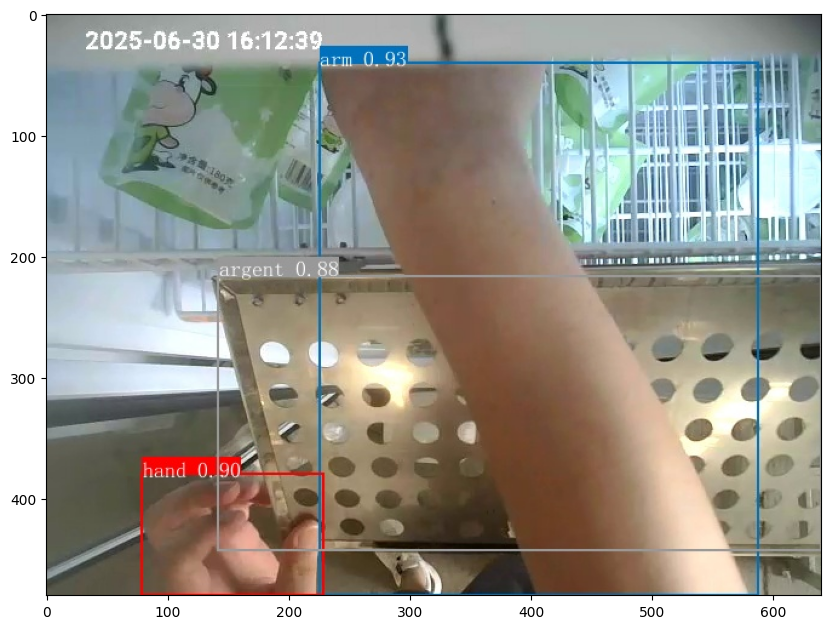

In [18]:
# 可视化推理效果
%matplotlib inline

import matplotlib.pyplot as plt
from PIL import Image

plt.figure(figsize=(10, 20))
plt.imshow(Image.open('/home/aistudio/output/0630_1_10.jpg'))
plt.show()

In [3]:
from IPython.display import HTML, display
from base64 import b64encode

def show_video(video_path, width=640, height=480, autoplay=False, loop=False, controls=True):
    """
    在Jupyter Notebook中显示MP4视频
    
    参数:
    video_path: 视频文件路径
    width: 视频宽度
    height: 视频高度
    autoplay: 是否自动播放
    loop: 是否循环播放
    controls: 是否显示控制条
    """
    # 读取视频文件
    mp4 = open(video_path, 'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    
    # 构建HTML视频标签
    autoplay_attr = "autoplay" if autoplay else ""
    loop_attr = "loop" if loop else ""
    controls_attr = "controls" if controls else ""
    
    video_html = f"""
    <video width={width} height={height} {controls_attr} {autoplay_attr} {loop_attr}>
        <source src="{data_url}" type="video/mp4">
        您的浏览器不支持视频标签。
    </video>
    """
    
    # 显示视频
    return HTML(video_html)

# 使用示例
video_path = "/home/aistudio/data_video/video_detection_output.mp4"  # 替换为你的MP4文件路径
show_video(video_path, width=800, height=450)